<a href="https://colab.research.google.com/github/jakubpiwowarski/Personal_protective_Equipment_detector./blob/main/PPE_detection_partly2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [2]:
from google.colab.patches import cv2_imshow

In [3]:
# Pip install method (recommended)

!pip install ultralytics==8.0.28

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.28 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.4/78.2 GB disk)


In [4]:
from ultralytics import YOLO

In [5]:
pip install cvzone

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
import cvzone
import math

In [7]:
import cv2

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
!pip install opencv-python-headless
!pip install google-colab

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [10]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [11]:
# from IPython.display import Image
# try:
#   filename = take_photo()
#   print('Saved to {}'.format(filename))

#   # Show the image which was just taken.
#   display(Image(filename))
# except Exception as err:
#   # Errors will be thrown if the user does not have a webcam or if they do not
#   # grant the page permission to access it.
#   print(str(err))

In [12]:
cap = cv2.VideoCapture('/content/drive/MyDrive/101-Object_Detection/Pliki/Videos/ppe-3.mp4')

In [13]:
model= YOLO('/content/drive/MyDrive/101-Object_Detection/Pliki/Project_3-PPE_Detection/ppe.pt')

In [14]:
classNames = ['Hardhat', 'Mask', 'NO-Hardhat', 'NO-Mask', 'NO-Safety Vest', 'Person', 'Safety Cone',
              'Safety Vest', 'machinery', 'vehicle']

In [15]:
myColor = (0,0,255)

Ultralytics YOLOv8.0.28 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs

0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 74.6ms
Speed: 0.6ms pre-process, 74.6ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.92
0.91
0.9
0.89
0.88
0.86
0.79
0.52
0.39


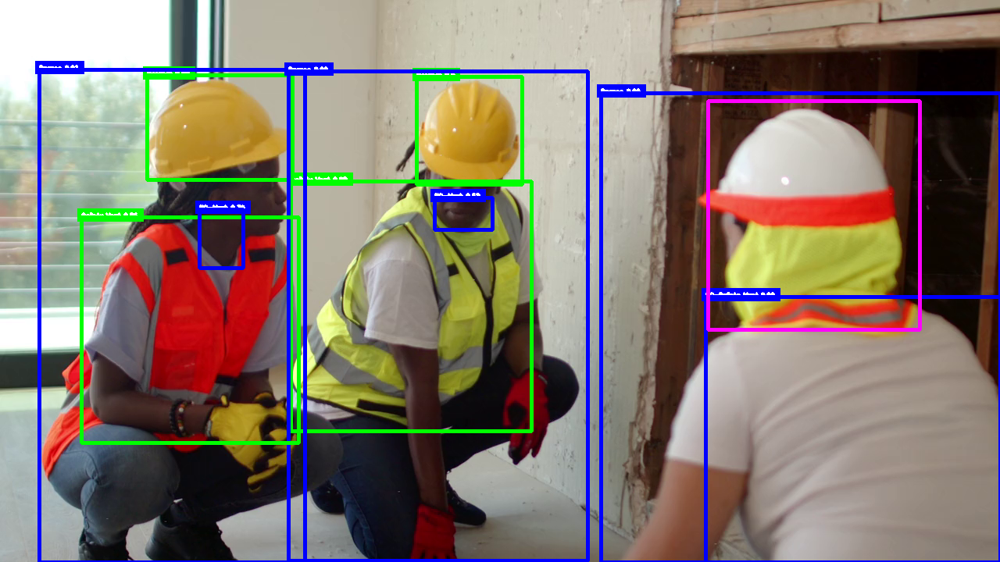


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 32.4ms
Speed: 0.6ms pre-process, 32.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.92
0.91
0.91
0.9
0.89
0.88
0.87
0.75
0.5
0.37


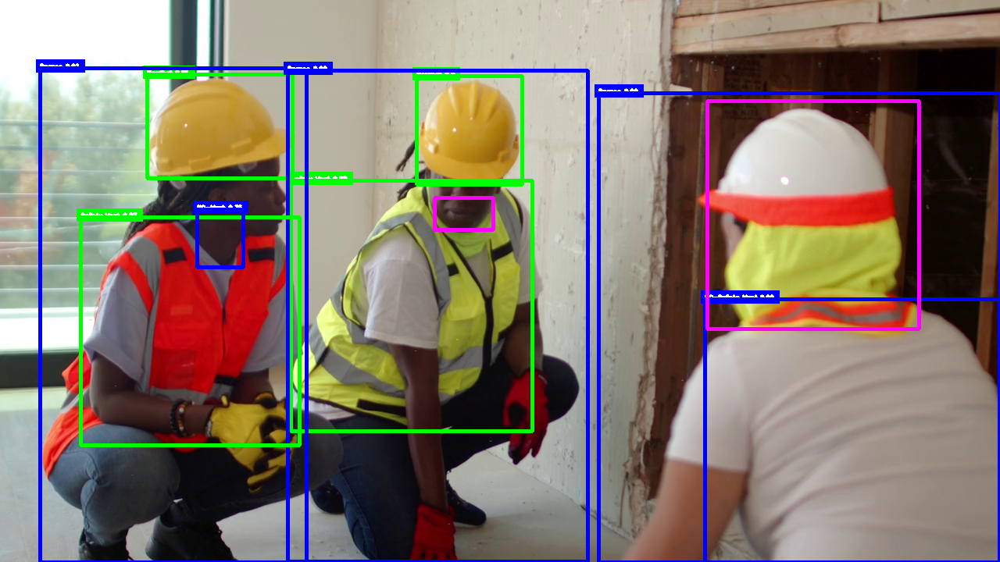


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 32.5ms
Speed: 0.6ms pre-process, 32.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.92
0.91
0.91
0.9
0.88
0.88
0.87
0.75
0.54
0.33


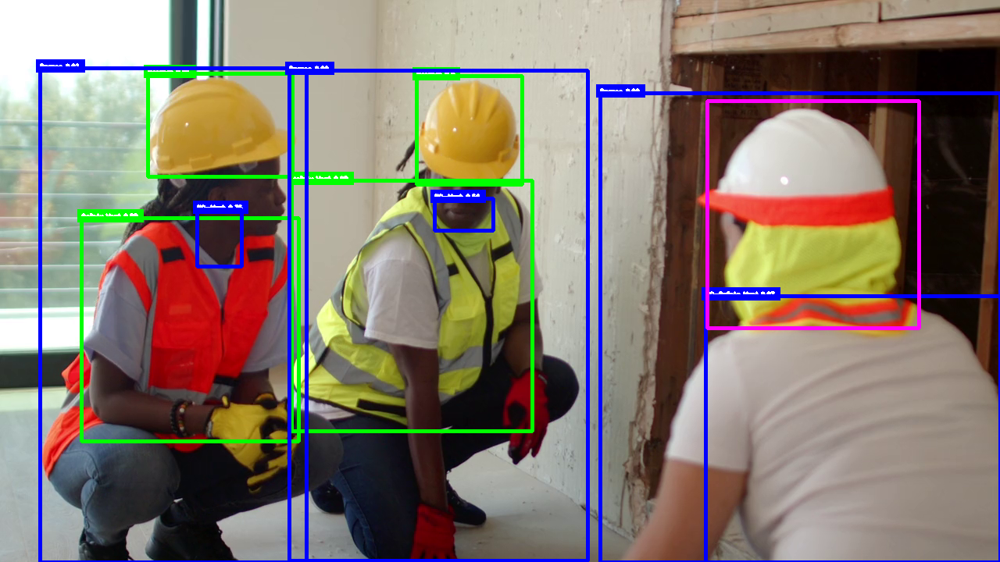


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 32.5ms
Speed: 0.7ms pre-process, 32.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.92
0.91
0.91
0.9
0.89
0.89
0.88
0.73
0.54
0.28


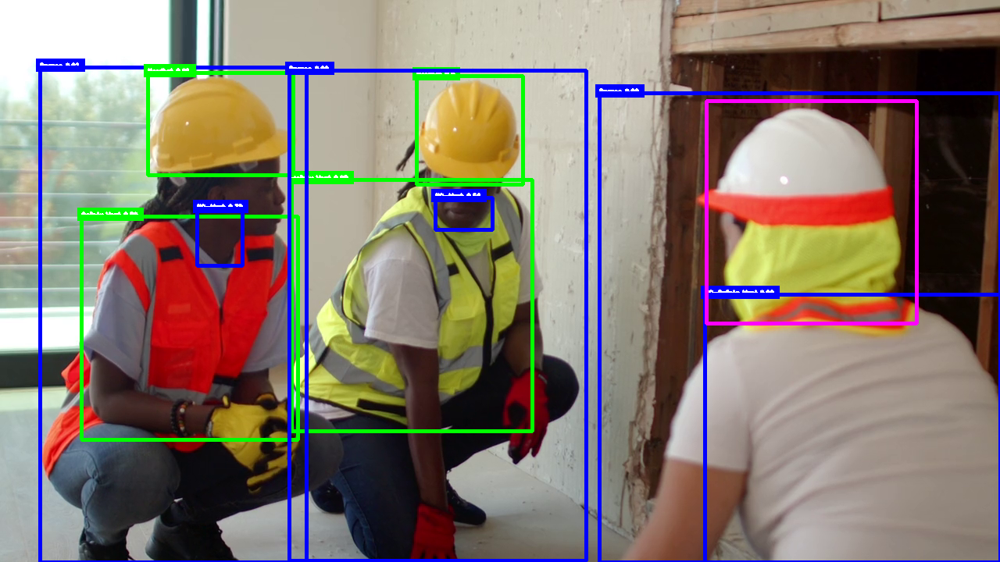


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 34.5ms
Speed: 0.7ms pre-process, 34.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.9
0.9
0.9
0.89
0.88
0.72
0.57
0.34


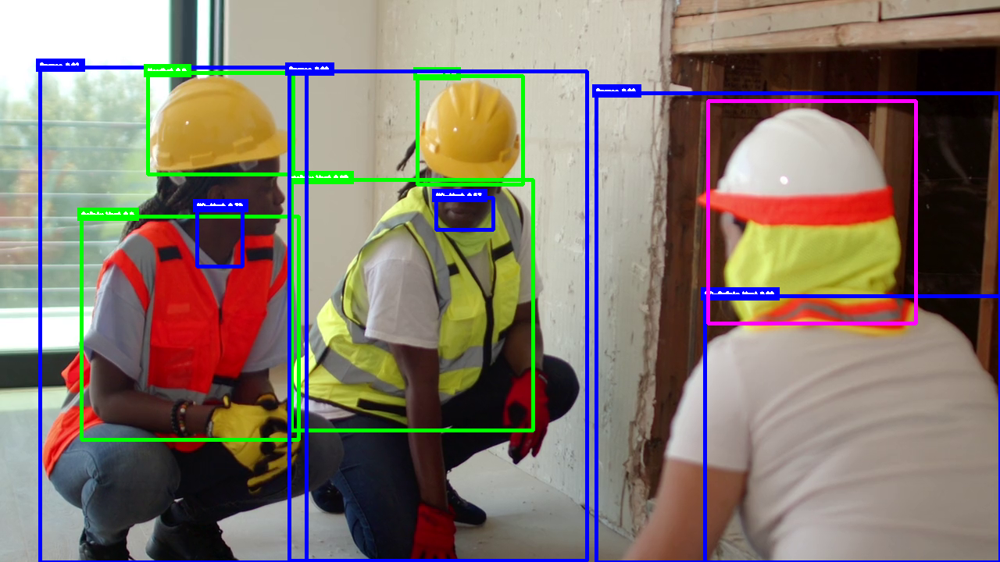


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 44.2ms
Speed: 0.6ms pre-process, 44.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.91
0.9
0.9
0.89
0.88
0.72
0.59
0.32


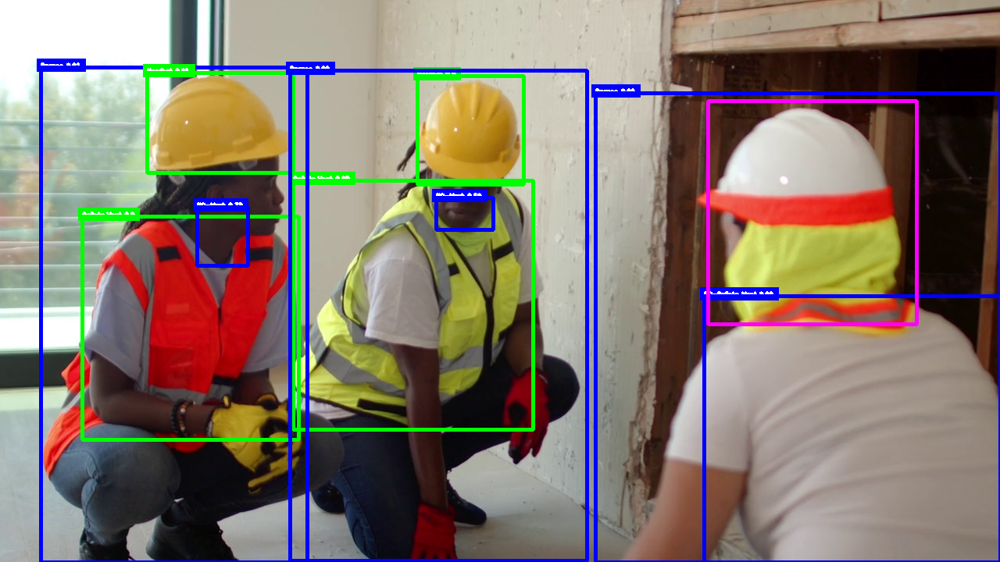


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 42.6ms
Speed: 0.6ms pre-process, 42.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.9
0.9
0.9
0.88
0.88
0.72
0.63
0.28


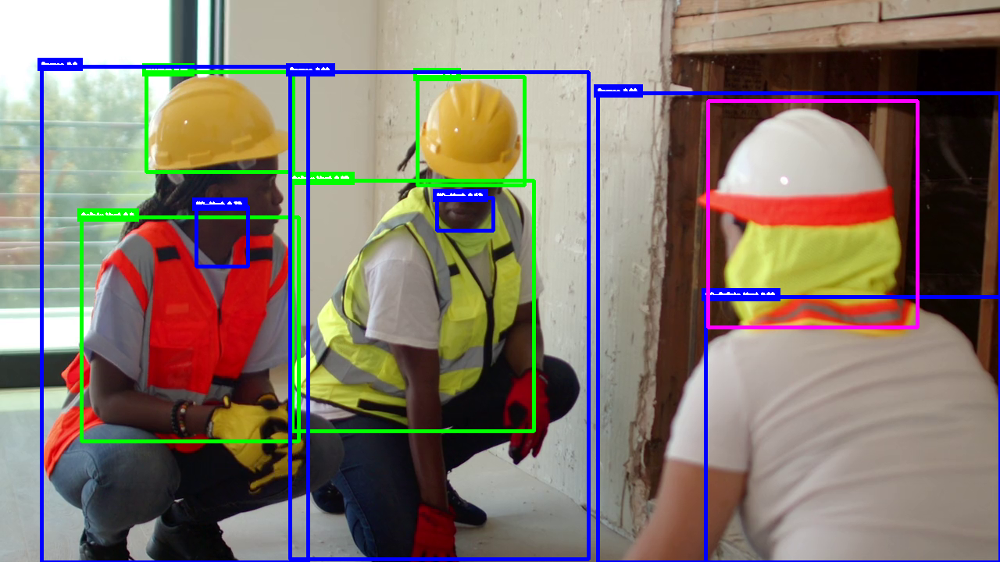


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.9ms
Speed: 0.6ms pre-process, 40.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.9
0.9
0.89
0.88
0.88
0.72
0.58
0.4


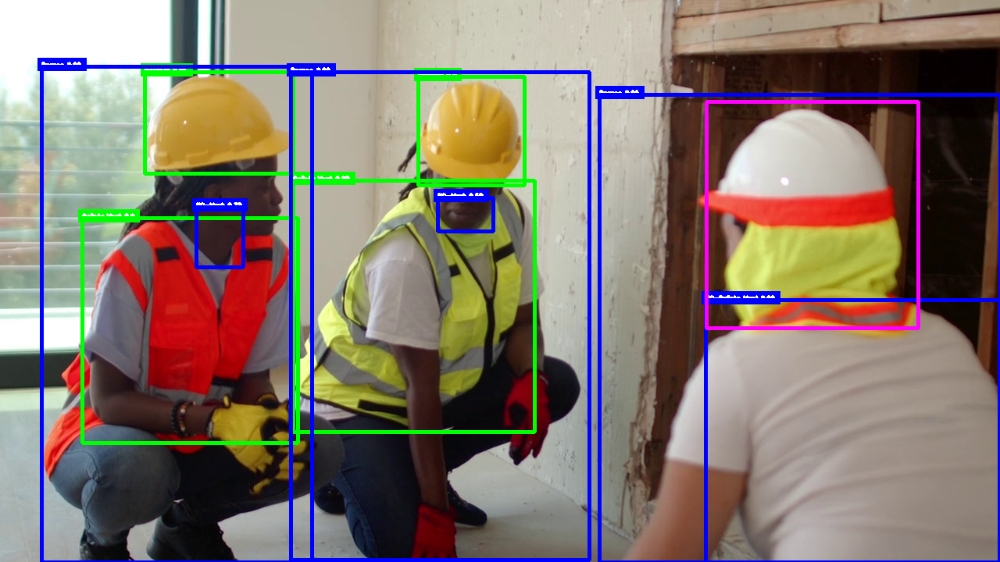


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 41.3ms
Speed: 0.7ms pre-process, 41.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.9
0.9
0.88
0.88
0.87
0.68
0.59
0.47


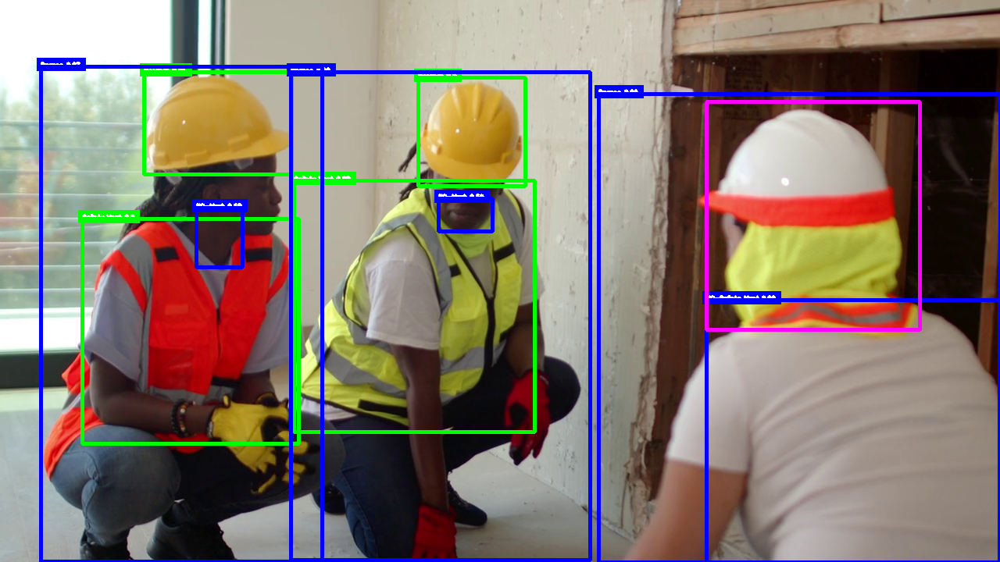


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.9ms
Speed: 0.6ms pre-process, 40.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.93
0.91
0.9
0.89
0.89
0.89
0.88
0.65
0.61
0.53
0.32


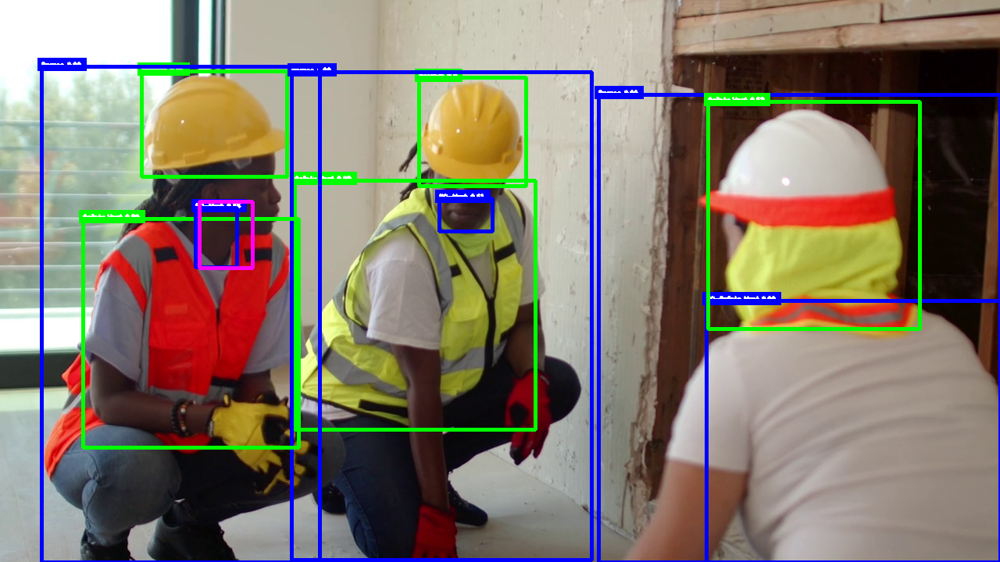


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.93
0.91
0.9
0.89
0.89
0.88
0.87
0.64
0.61
0.52
0.26


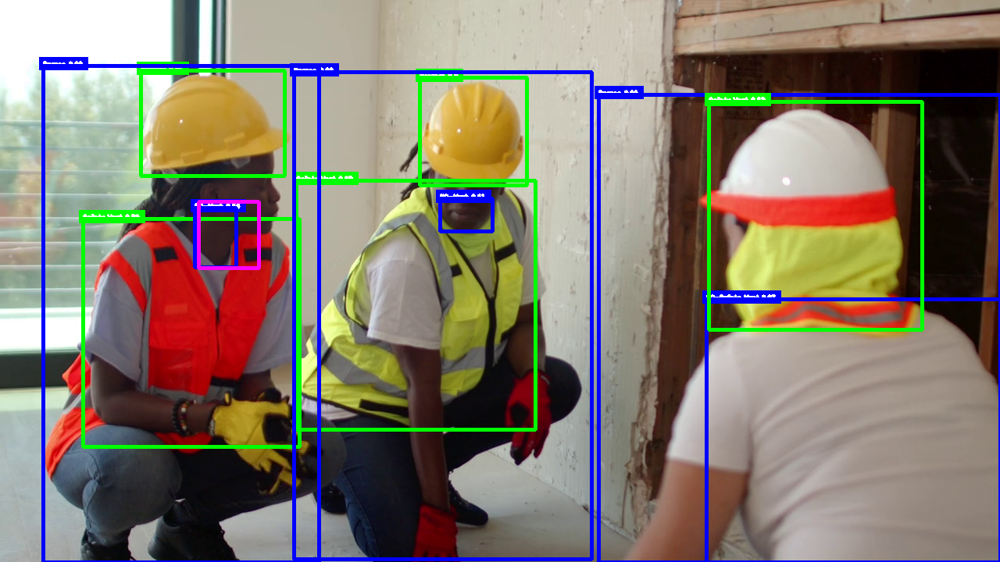


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 43.7ms
Speed: 0.7ms pre-process, 43.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.93
0.91
0.9
0.9
0.89
0.88
0.88
0.61
0.57
0.51
0.32


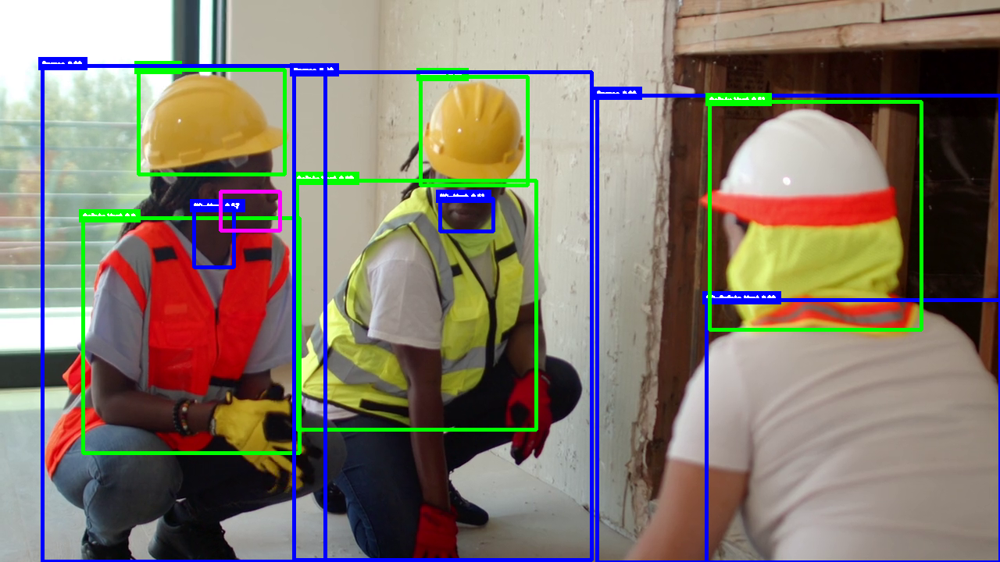


0: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.91
0.91
0.9
0.89
0.88
0.86
0.62
0.57
0.43


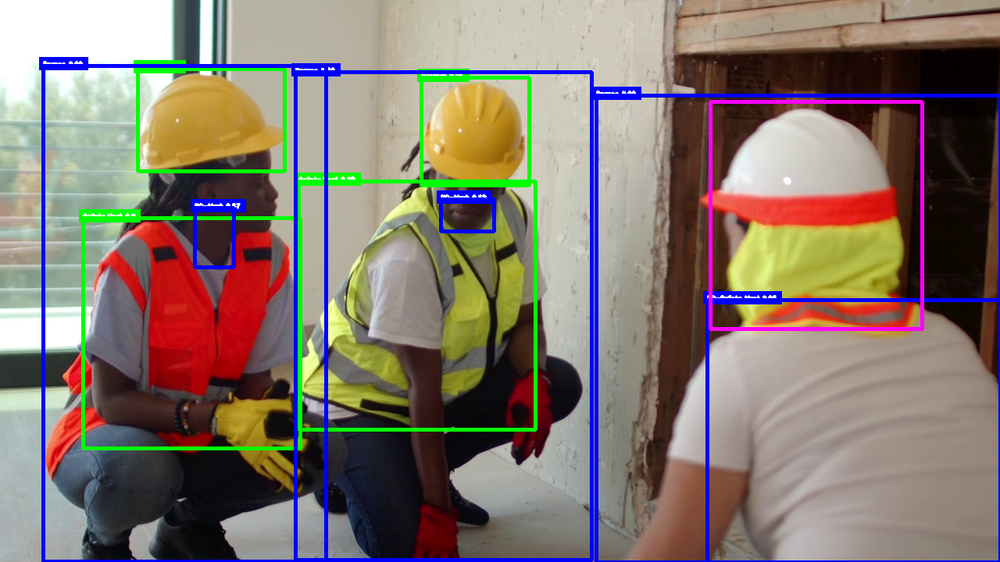


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.91
0.91
0.9
0.89
0.89
0.87
0.61
0.54
0.36
0.29


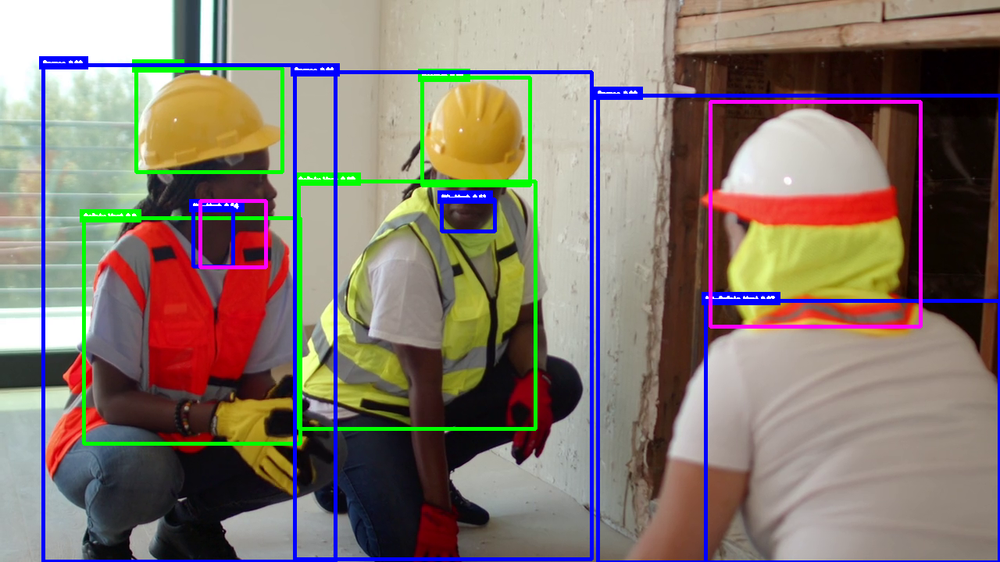


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 44.8ms
Speed: 0.6ms pre-process, 44.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.91
0.91
0.9
0.9
0.87
0.86
0.62
0.58
0.28
0.27


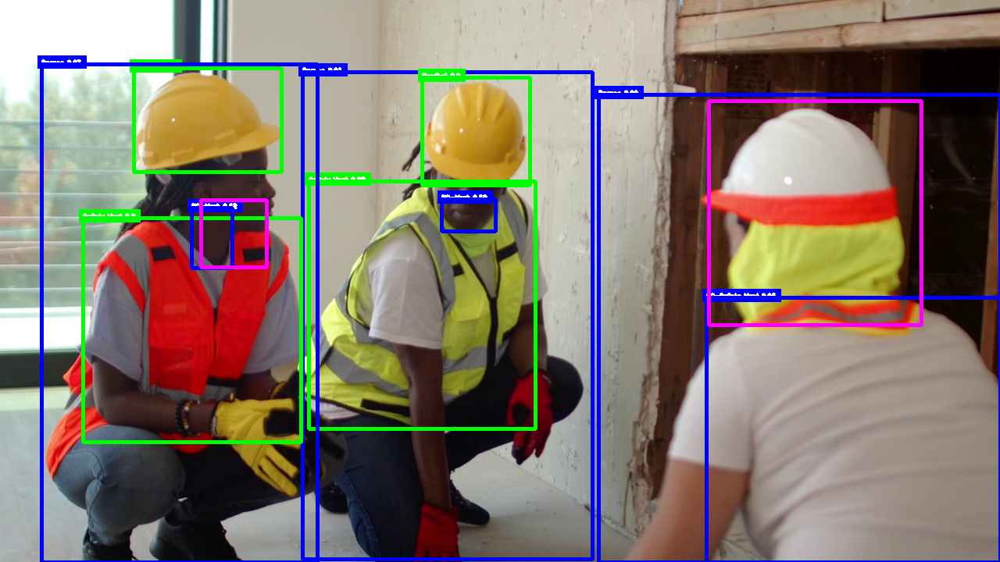


0: 384x640 2 Hardhats, 4 NO-Masks, 1 NO-Safety Vest, 3 Persons, 2 Safety Vests, 45.1ms
Speed: 0.6ms pre-process, 45.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.91
0.9
0.9
0.9
0.87
0.83
0.65
0.58
0.34
0.33


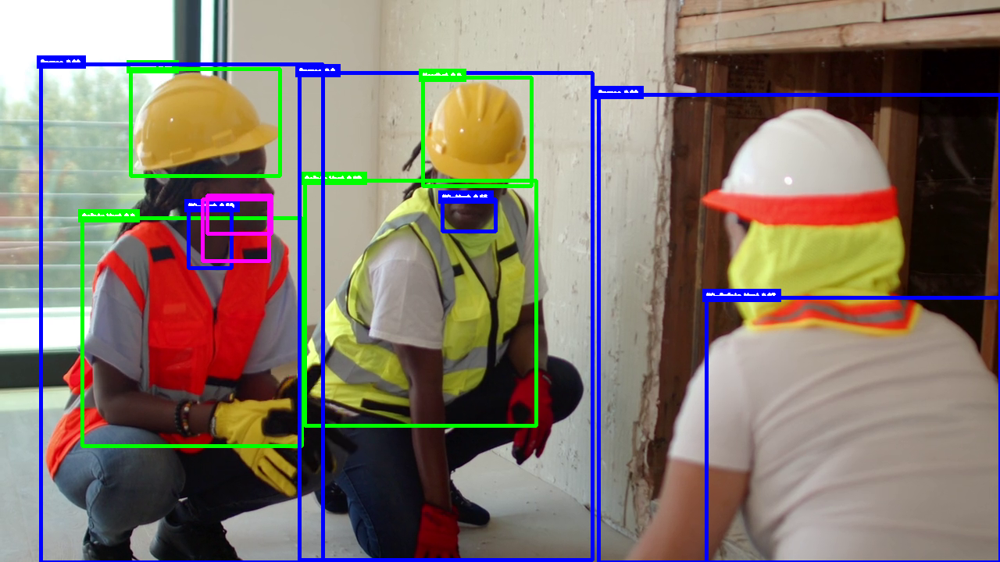


0: 384x640 2 Hardhats, 5 NO-Masks, 1 NO-Safety Vest, 3 Persons, 2 Safety Vests, 40.8ms
Speed: 0.7ms pre-process, 40.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.9
0.9
0.89
0.89
0.87
0.86
0.64
0.55
0.43
0.36
0.31


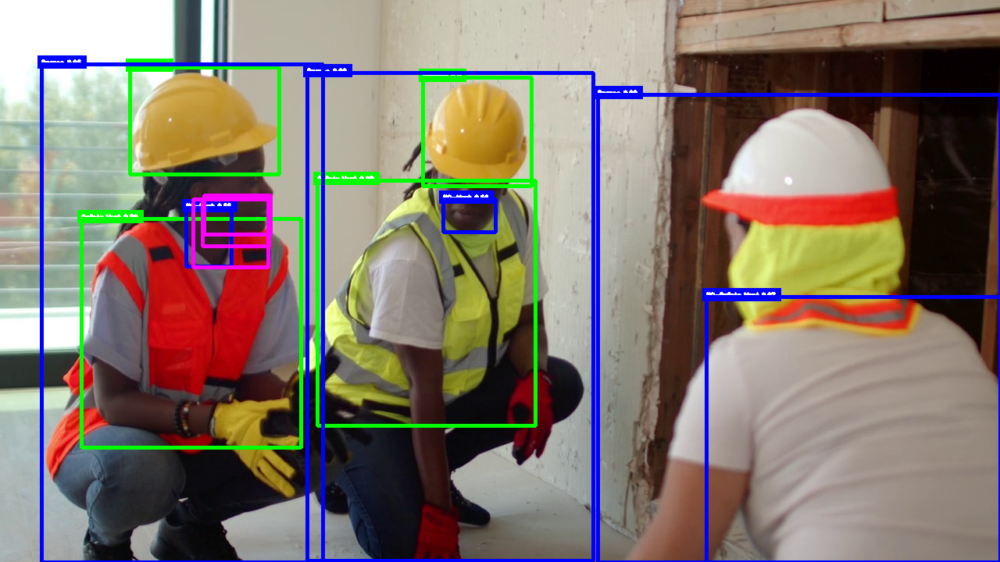


0: 384x640 2 Hardhats, 4 NO-Masks, 1 NO-Safety Vest, 3 Persons, 2 Safety Vests, 40.9ms
Speed: 0.6ms pre-process, 40.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.93
0.9
0.9
0.9
0.89
0.87
0.84
0.67
0.63
0.51
0.29


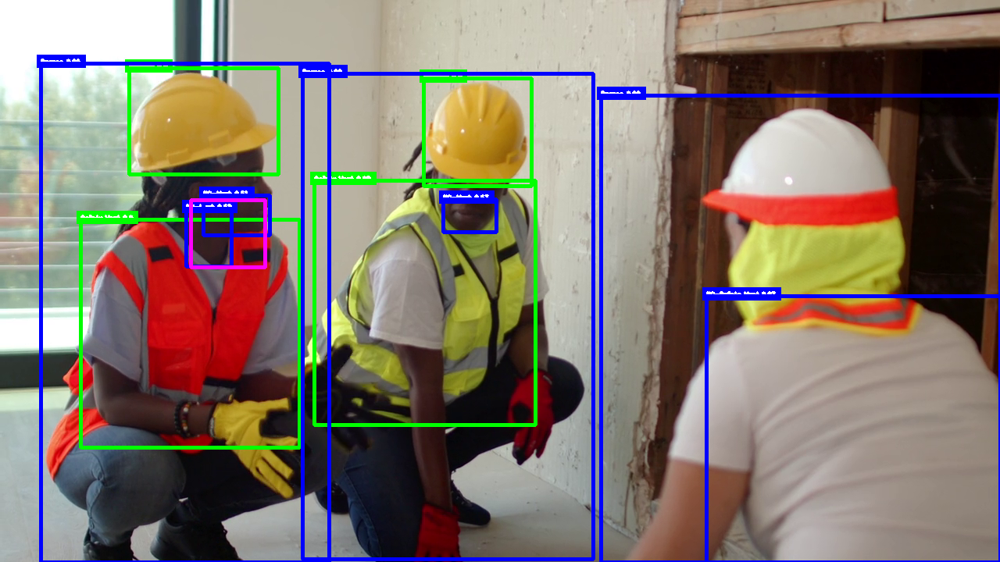


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 41.7ms
Speed: 0.7ms pre-process, 41.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.91
0.9
0.9
0.9
0.87
0.86
0.84
0.67
0.64
0.53
0.3


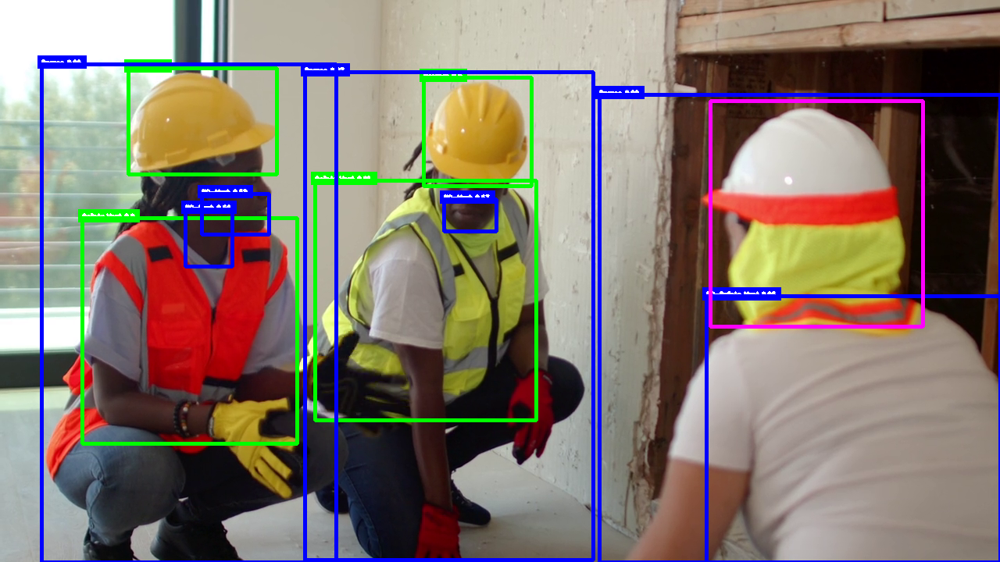


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.91
0.9
0.9
0.89
0.88
0.87
0.87
0.67
0.65
0.59
0.26


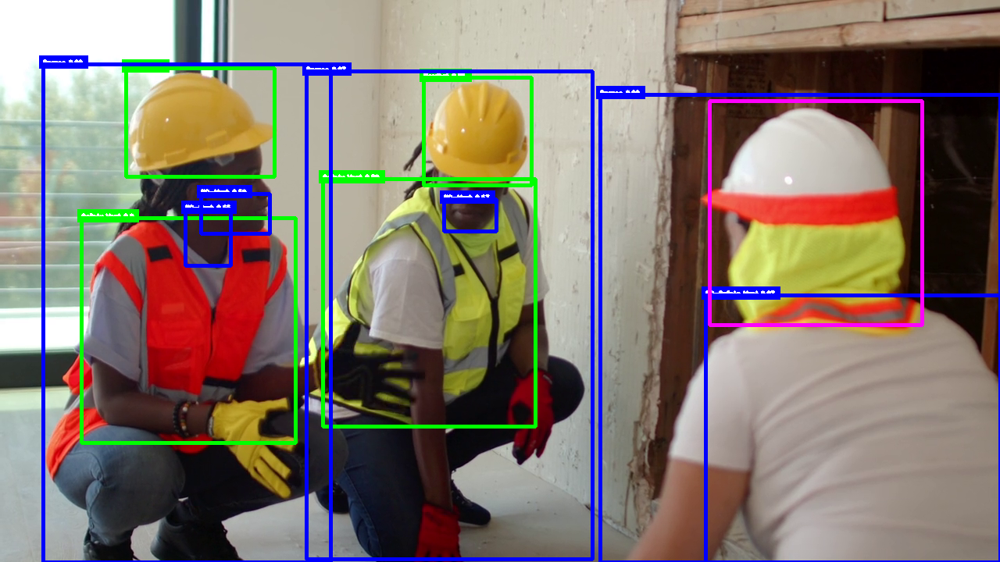


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


0.93
0.91
0.9
0.9
0.9
0.88
0.86
0.84
0.69
0.61
0.55
0.29


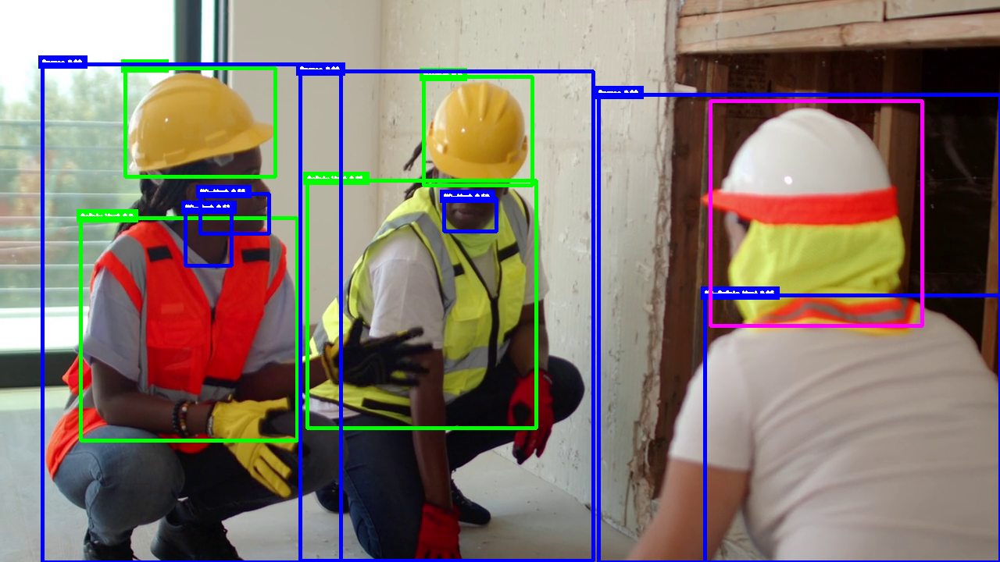


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.7ms pre-process, 40.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.93
0.9
0.9
0.89
0.87
0.87
0.81
0.73
0.64
0.61
0.29


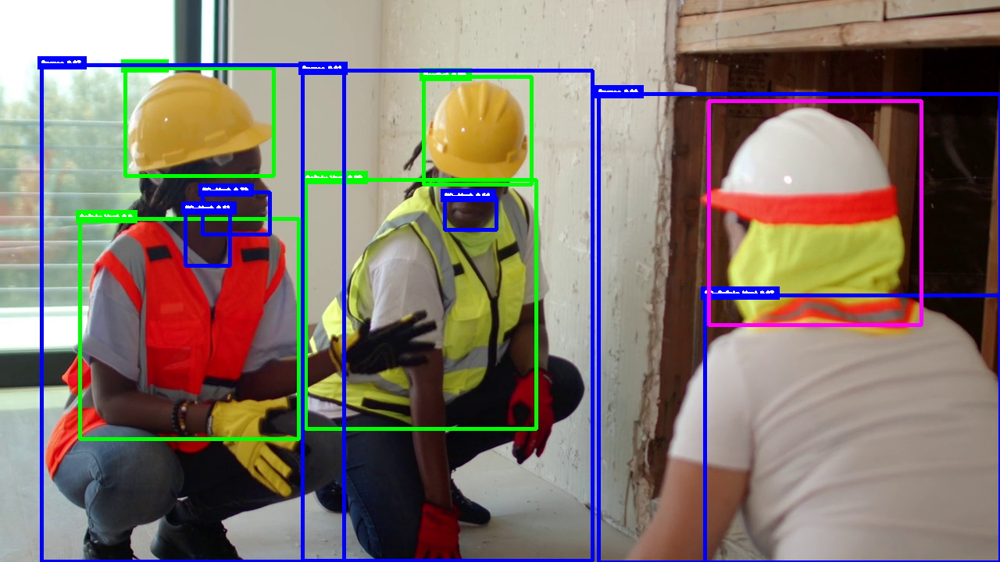


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 56.2ms
Speed: 0.7ms pre-process, 56.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.9
0.9
0.88
0.88
0.87
0.78
0.72
0.69
0.67
0.31


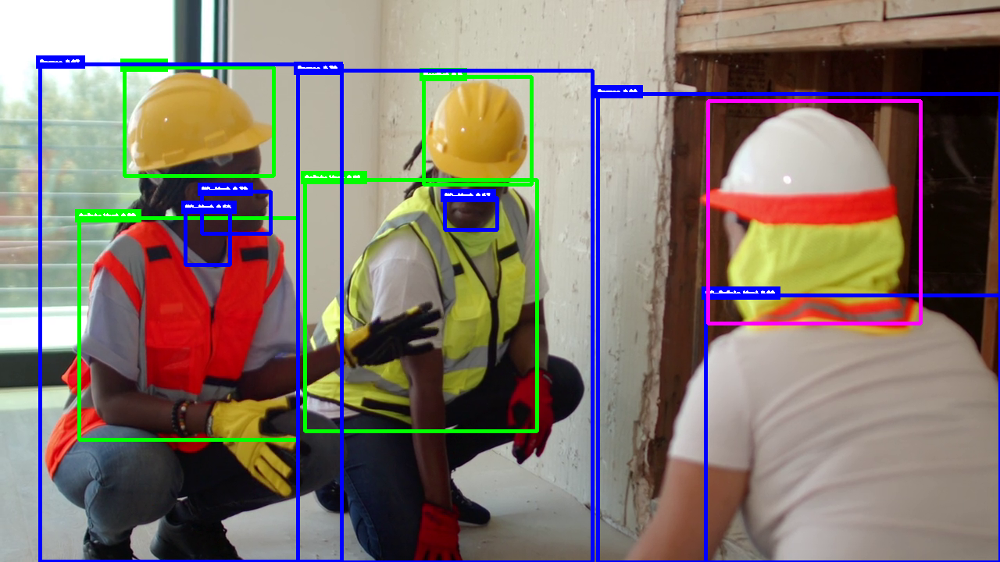


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.91
0.9
0.89
0.88
0.85
0.77
0.73
0.67
0.65
0.34


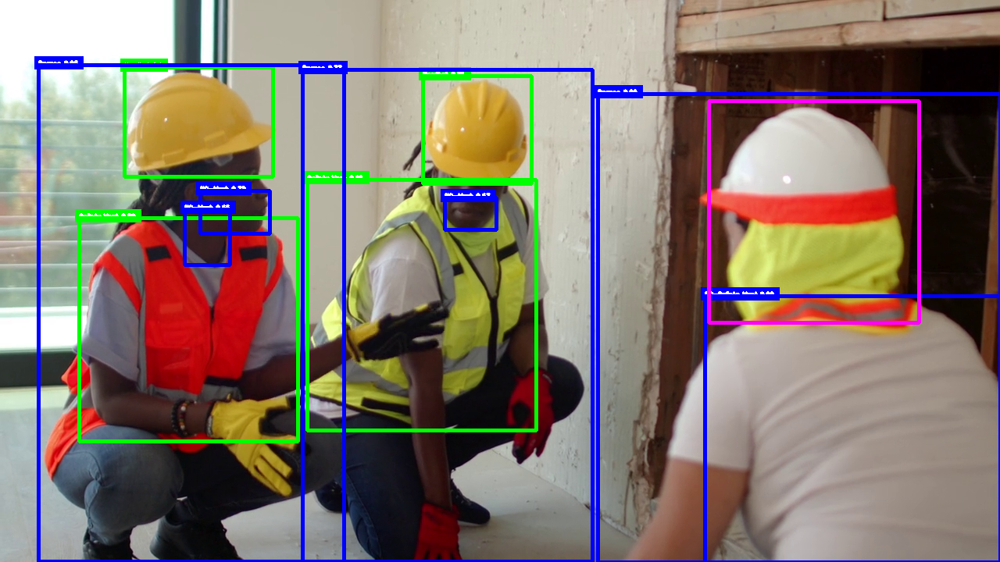


0: 384x640 3 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.9
0.9
0.89
0.88
0.85
0.74
0.72
0.62
0.6
0.29
0.26


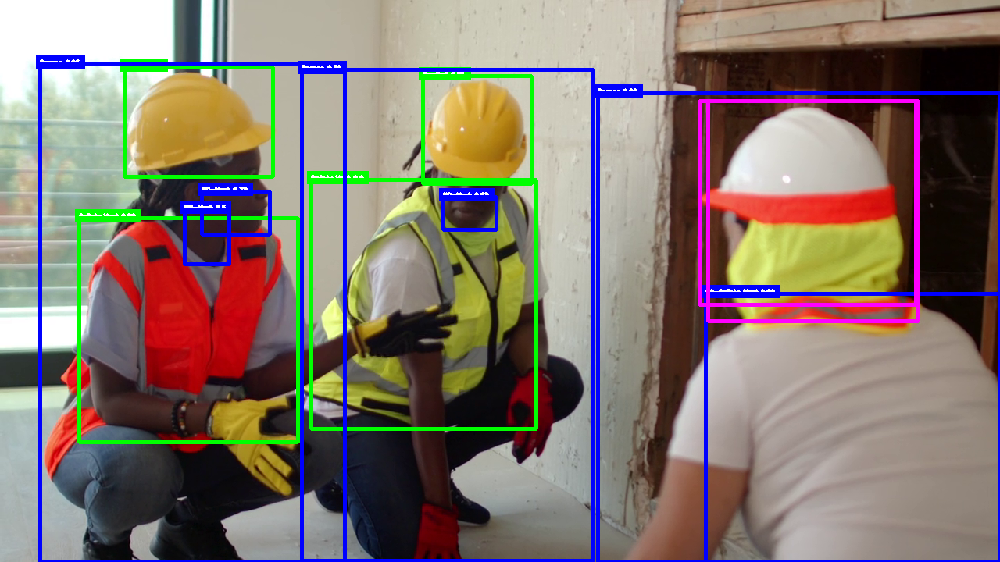


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.9ms
Speed: 0.6ms pre-process, 40.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.9
0.9
0.88
0.88
0.88
0.86
0.73
0.58
0.53
0.34


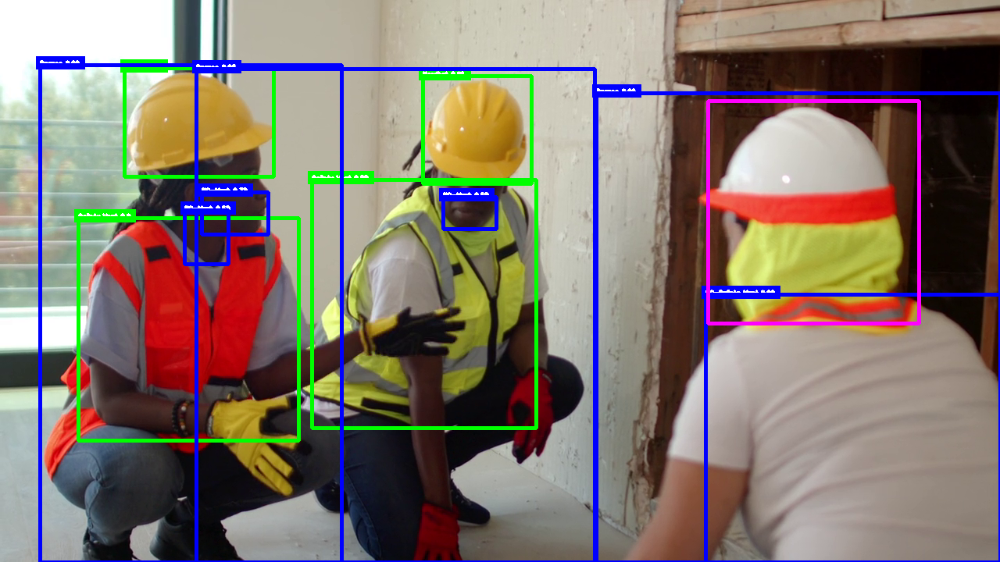


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.9
0.89
0.89
0.88
0.88
0.86
0.69
0.6
0.39
0.3


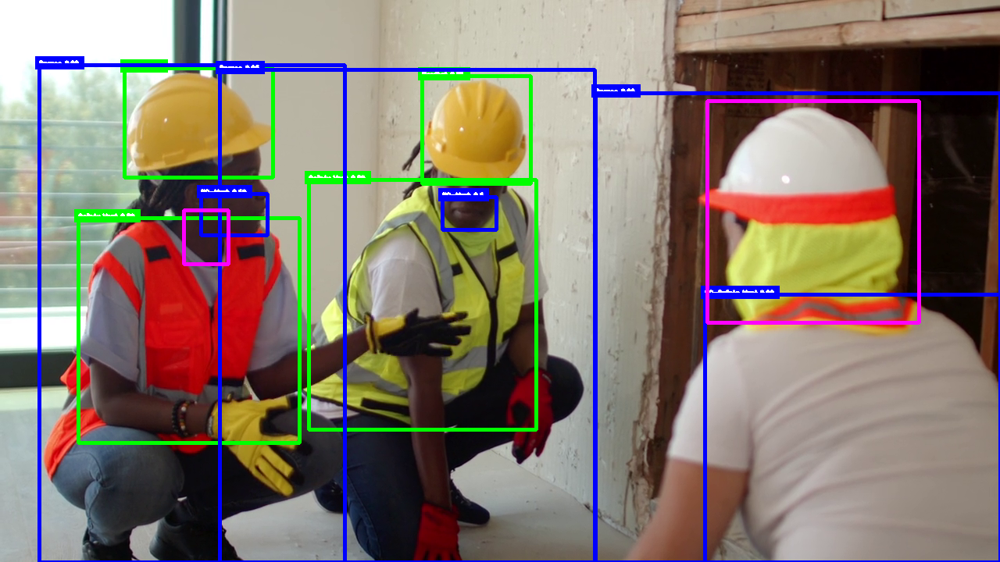


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.91
0.89
0.89
0.88
0.88
0.87
0.73
0.59
0.4
0.38


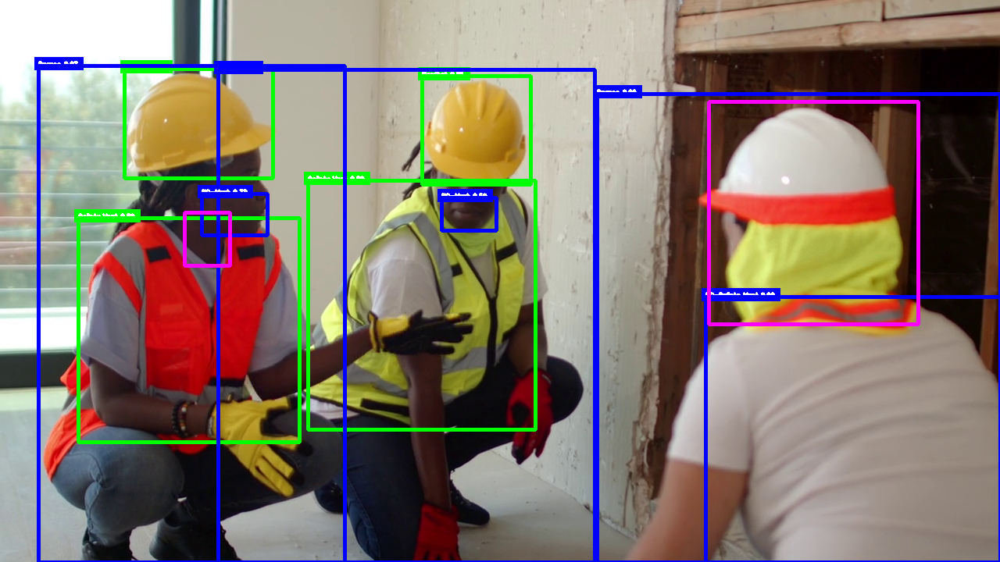


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 2.7ms pre-process, 40.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.91
0.91
0.91
0.9
0.88
0.88
0.64
0.6
0.6
0.43


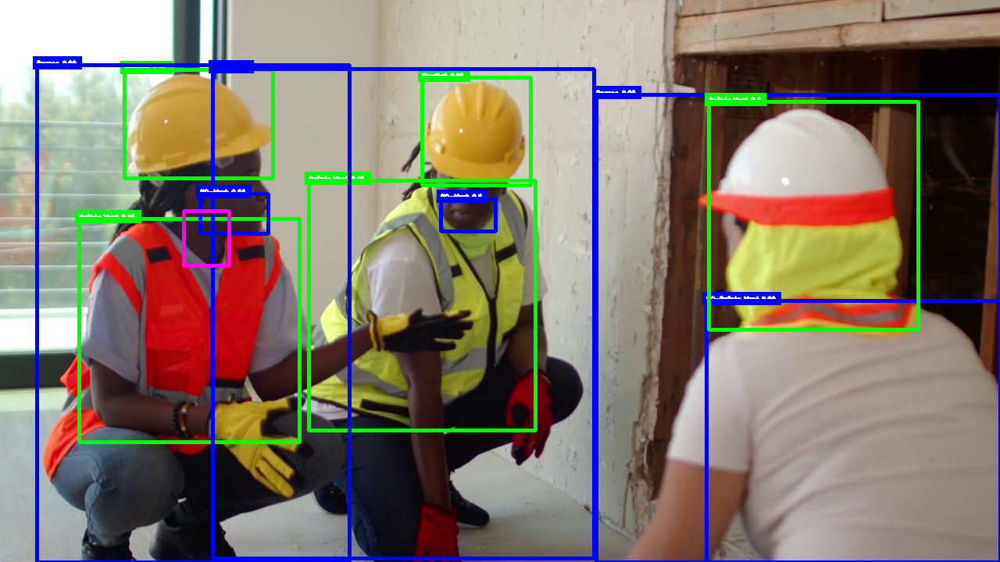


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 46.3ms
Speed: 0.7ms pre-process, 46.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.91
0.9
0.89
0.89
0.88
0.63
0.63
0.58
0.57


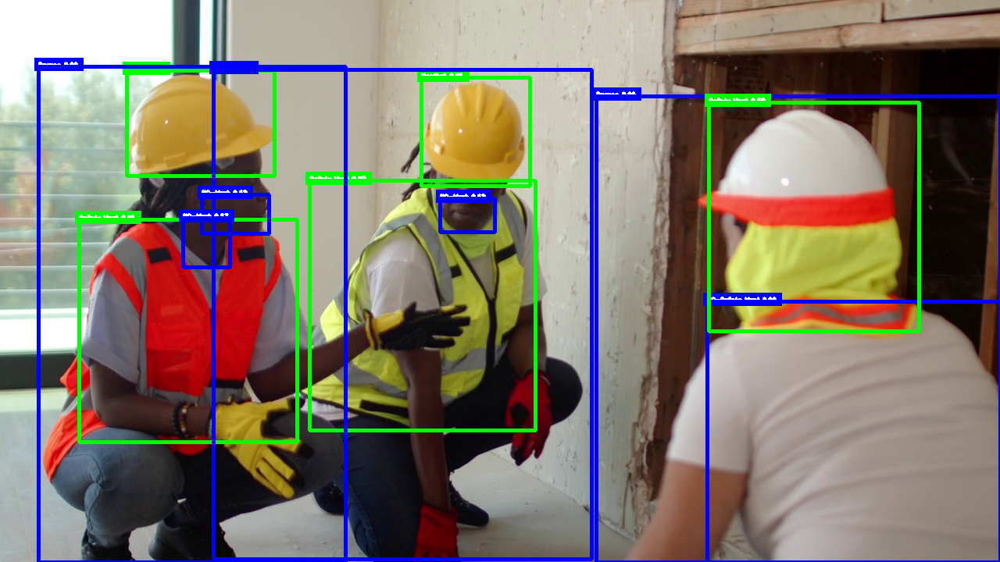


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.6ms pre-process, 40.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.91
0.91
0.9
0.9
0.9
0.87
0.87
0.66
0.56
0.51
0.45


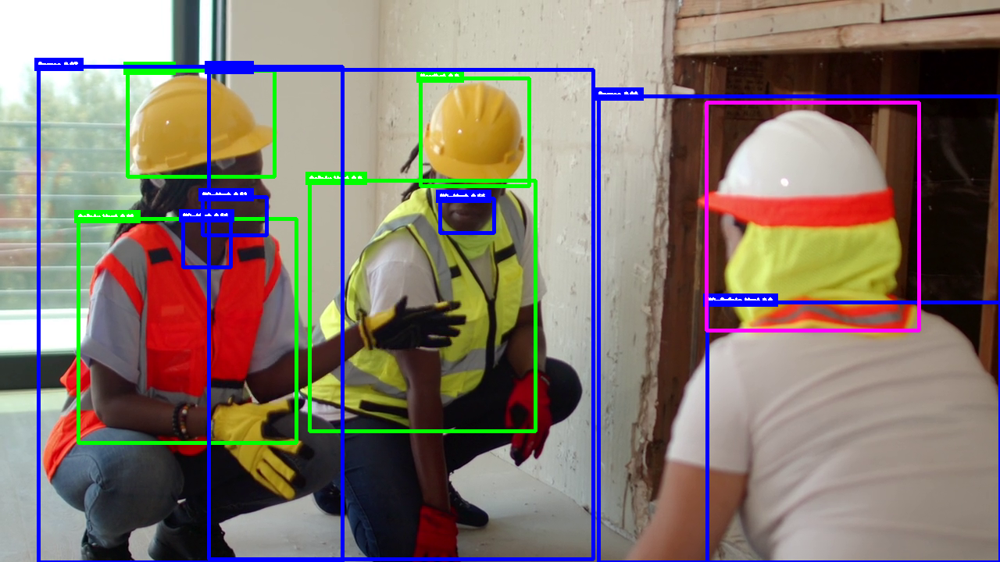


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.7ms pre-process, 40.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.91
0.91
0.9
0.9
0.88
0.86
0.68
0.52
0.49
0.39


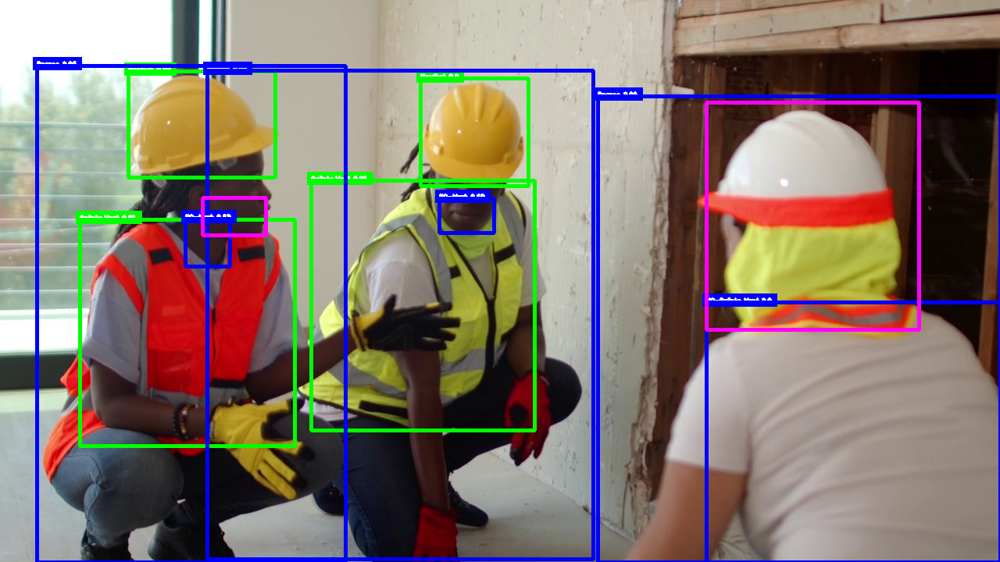


0: 384x640 2 Hardhats, 5 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 40.8ms
Speed: 0.7ms pre-process, 40.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


0.94
0.92
0.9
0.9
0.9
0.89
0.86
0.86
0.68
0.48
0.48
0.34
0.28
0.26


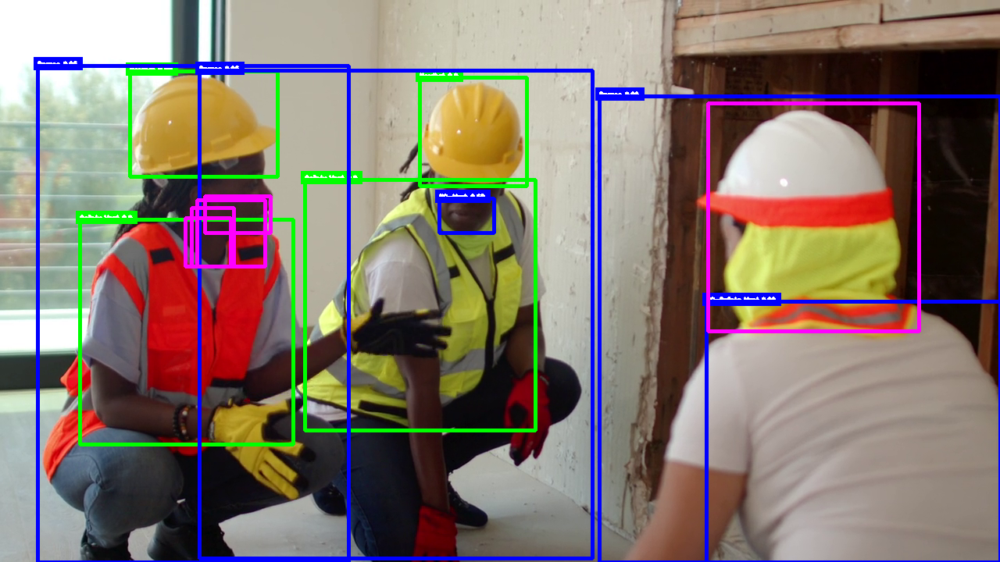


0: 384x640 2 Hardhats, 3 NO-Masks, 1 NO-Safety Vest, 3 Persons, 3 Safety Vests, 41.1ms
Speed: 0.6ms pre-process, 41.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


In [ ]:
while True:
    success, img = cap.read()
    results = model(img,stream=True)
    for r in results:
        boxes = r.boxes
        for box in boxes:
            #bounding box
            x1,y1,x2,y2 = box.xyxy[0]
            x1, y1, x2, y2 = int(x1),int(y1),int(x2),int(y2)
            # cv2.rectangle(img,(x1,y1),(x2,y2),(255,0,255),3)
            w, h = x2-x1, y2-y1
            bbox = int(x1), int(y1), int(x2), int(y2)
            # cvzone.cornerRect(img,(x1,y1,w,h))
            cv2.rectangle(img,(x1,y1),(x2,y2),(255,0,255),3)
            #confidence
            conf = math.ceil((box.conf[0]*100))/100
            print(conf)

            #clas name
            cls = int(box.cls[0])
            CurrentClass = classNames[cls]
            if conf > 0.5:
              if CurrentClass == 'No-Hardhat' or CurrentClass == 'No-Mask' or CurrentClass == 'No-Safety Vest':
                myColor = (0,0,255)
              elif CurrentClass == 'Hardhat' or CurrentClass == 'Safety Vest' or CurrentClass == 'Mask':
                myColor = (0,255,0)
              else:
                  myColor = (255,0,0)
              cvzone.putTextRect(img, f'{classNames[cls]} {conf}', (max(0, x1), max(35, y1)),scale=0.5,thickness=2,
                                colorB=myColor,colorT=(255,255,255),colorR=myColor, offset=5)
              cv2.rectangle(img,(x1,y1),(x2,y2),myColor,3)

    cv2_imshow(img)
    cv2.waitKey(1)
